In [ ]:
from google.colab import drive

drive.mount('/content/drive')



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5
%cd yolov5

# Install dependencies
!pip install -r requirements.txt


fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5/yolov5


In [ ]:
!python train.py --img-size 640 --batch-size 16 --epochs 100 --data /content/drive/MyDrive/football_players_detection/data.yaml --weights yolov5x.pt --name custom_model


2024-08-24 15:50:46.267909: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-24 15:50:46.303710: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-24 15:50:46.314654: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5x.pt, cfg=, data=/content/drive/MyDrive/football_players_detection/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, 

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-8-24 Python-3.10.12 torch-2.3.1+cu121 CPU

100%|██████████| 166M/166M [00:03<00:00, 51.9MB/s]

Fusing layers... 
YOLOv5x summary: 444 layers, 86705005 parameters, 0 gradients, 205.5 GFLOPs
Adding AutoShape... 


Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


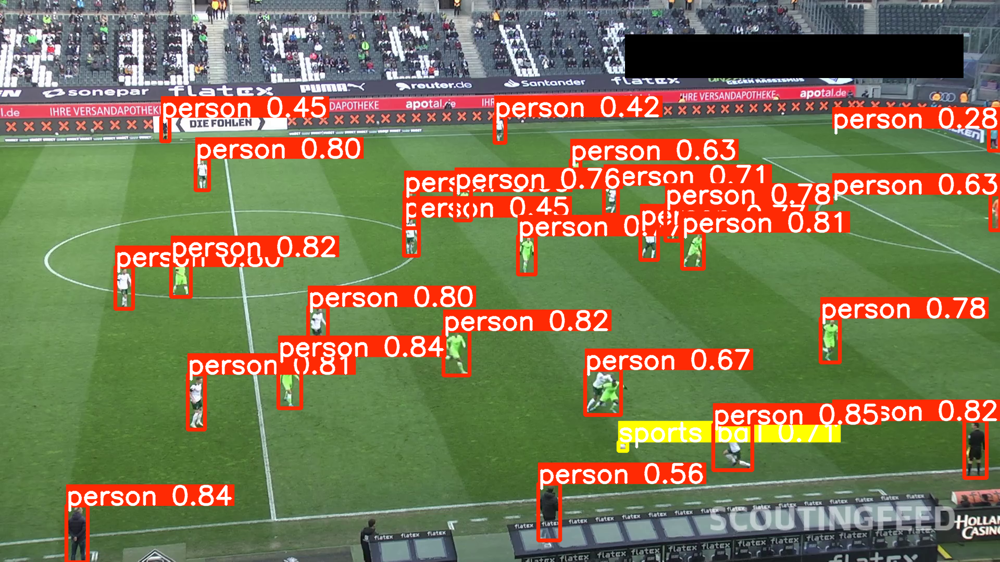

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


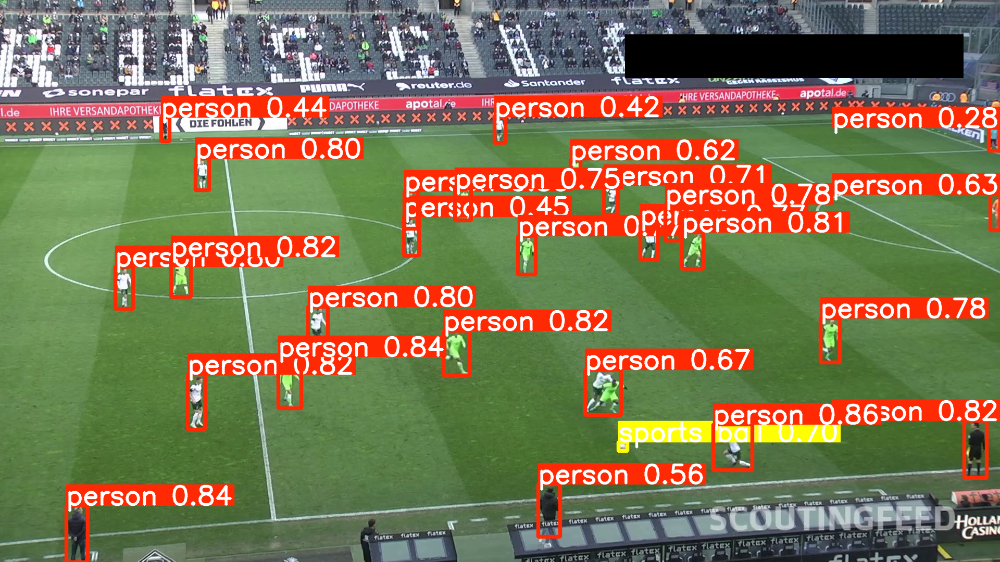

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


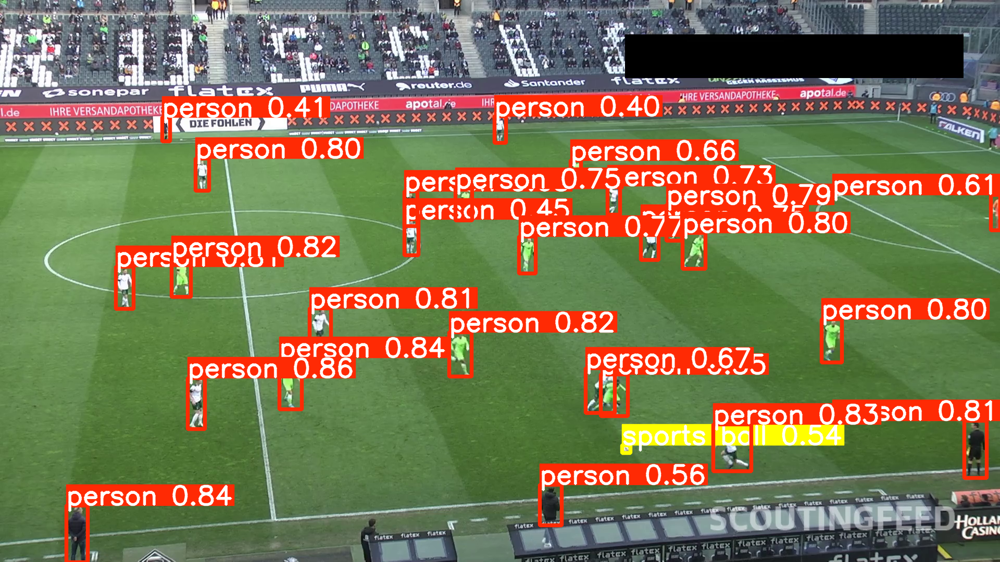

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


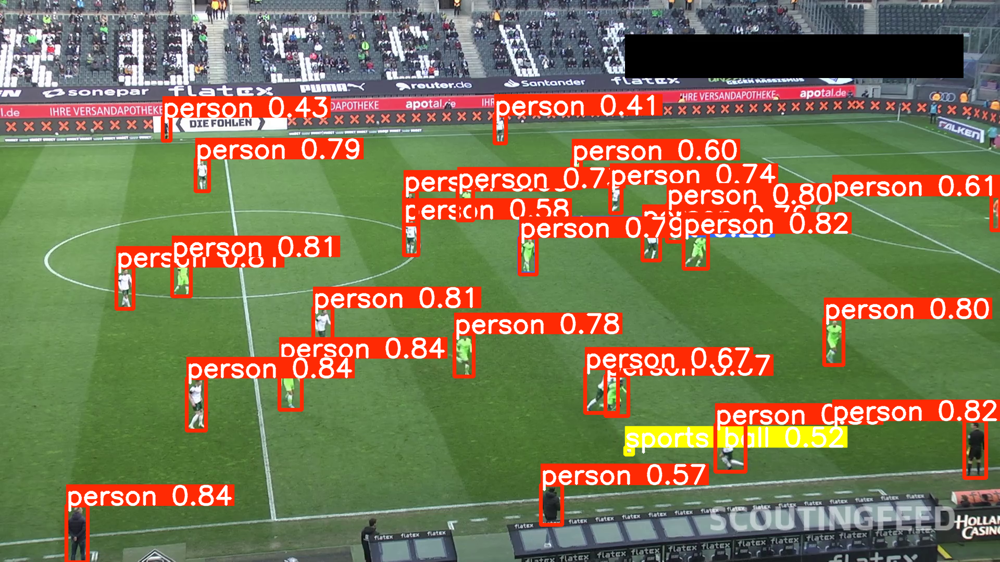

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


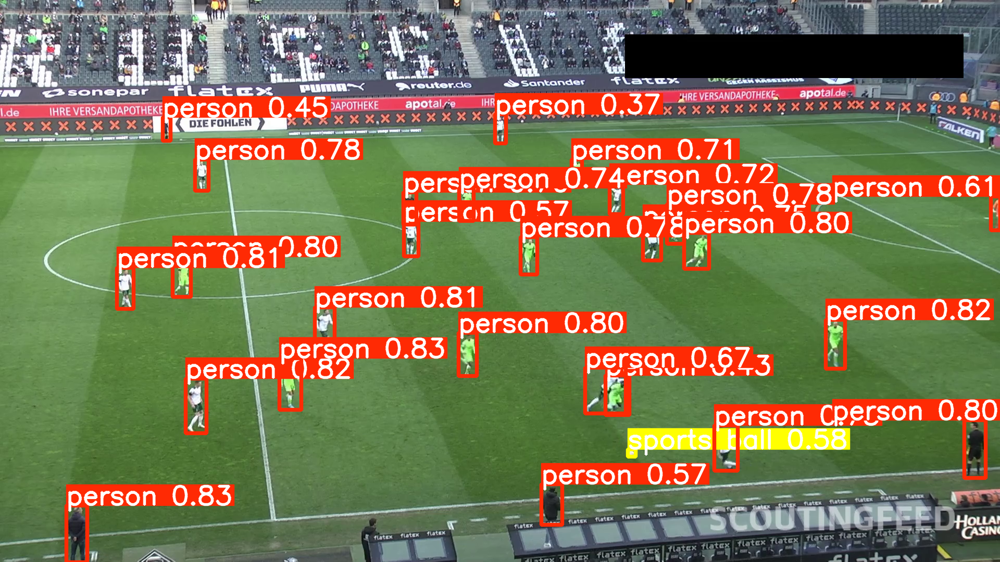

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


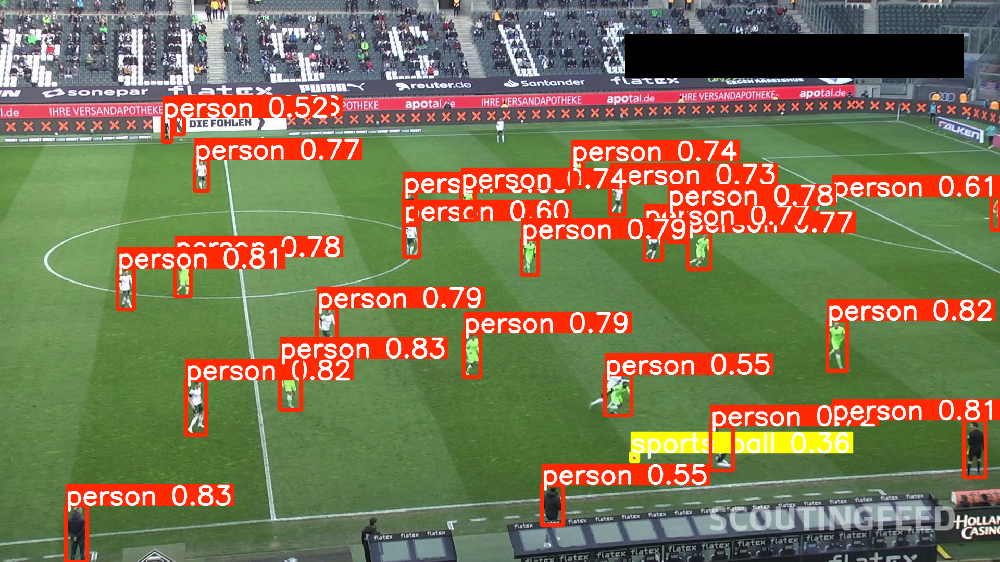

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


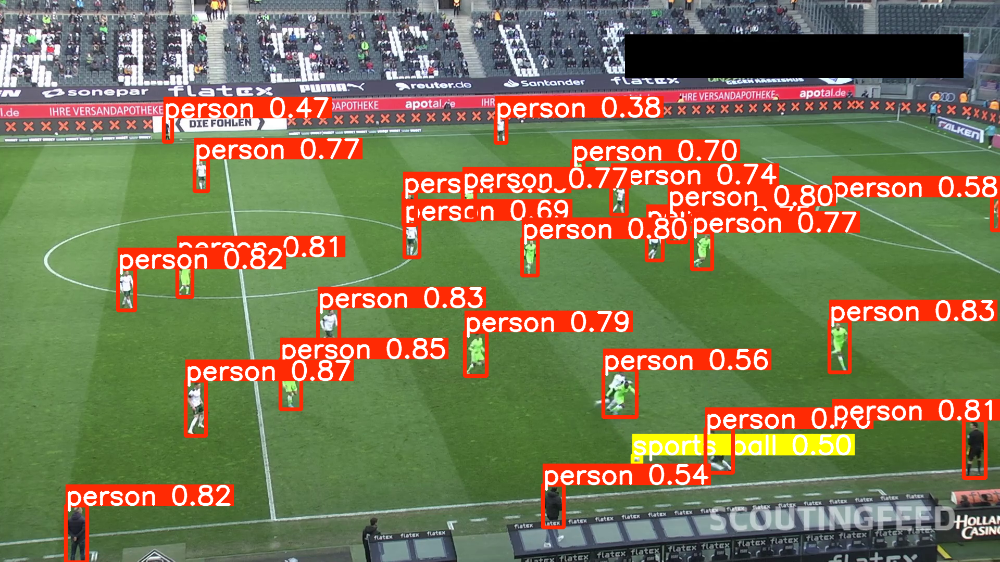

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


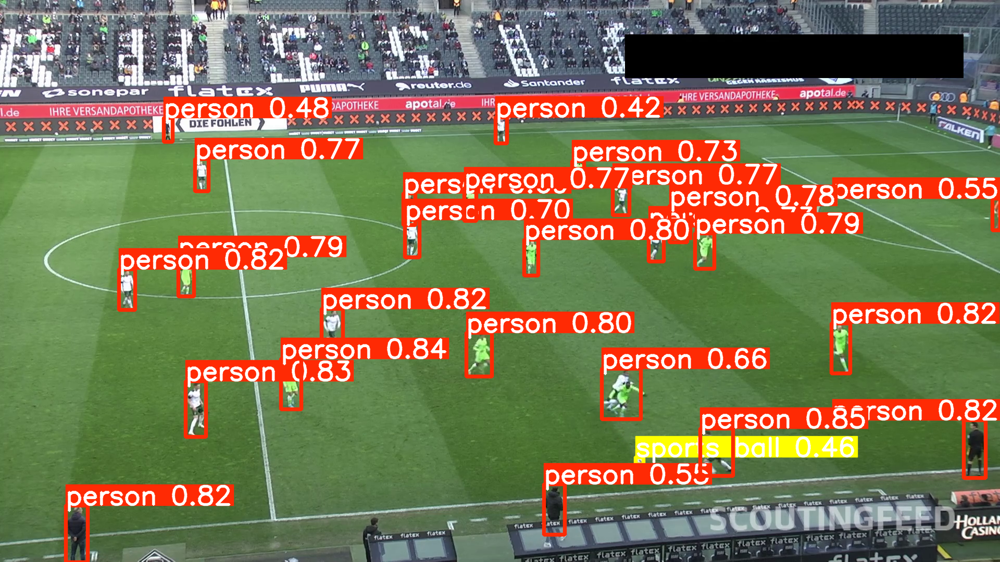

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


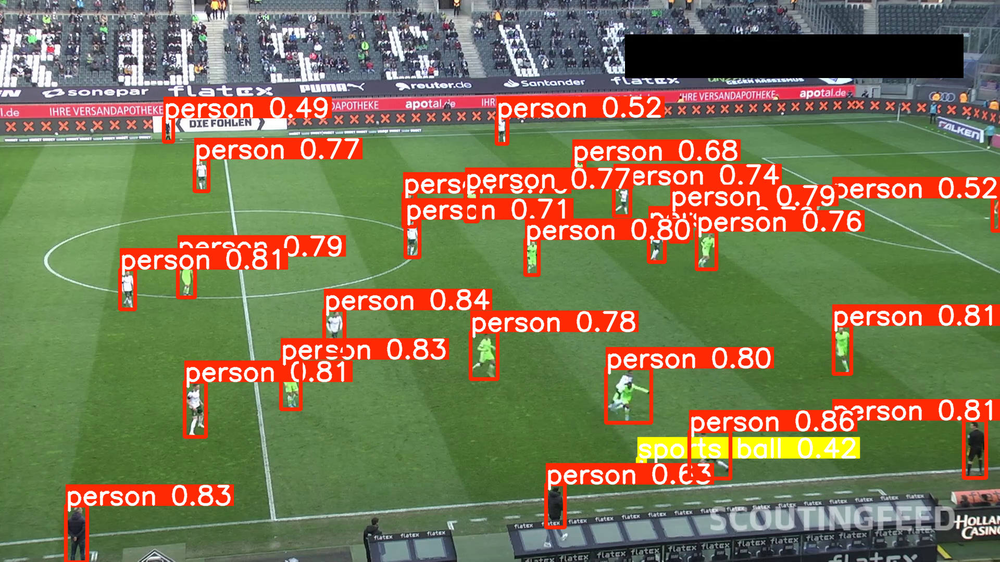

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


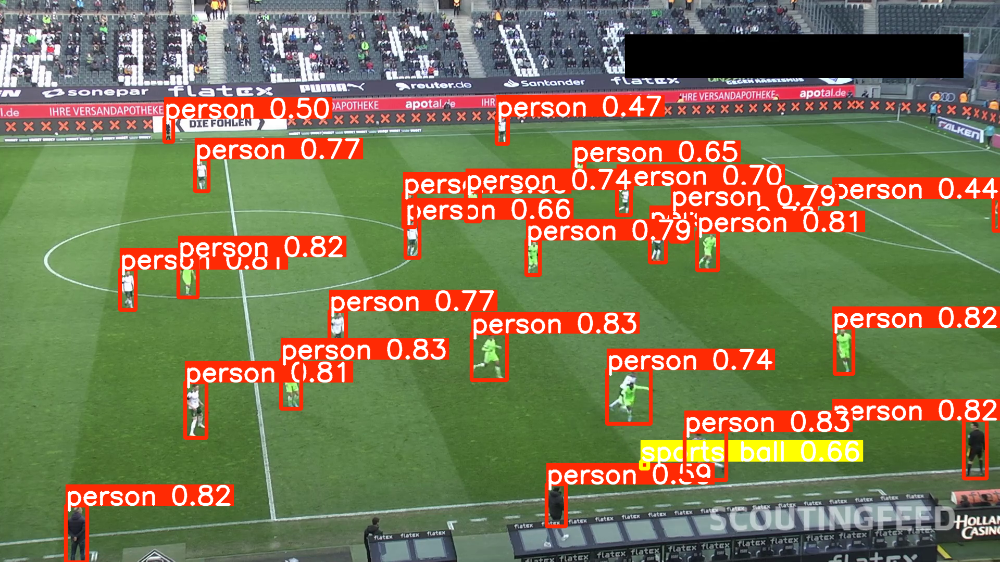

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


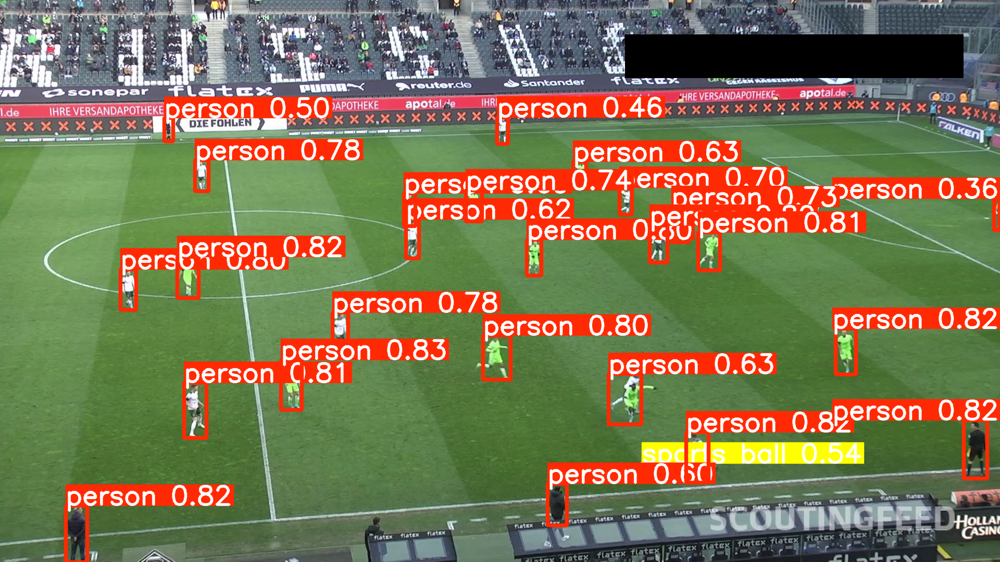

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


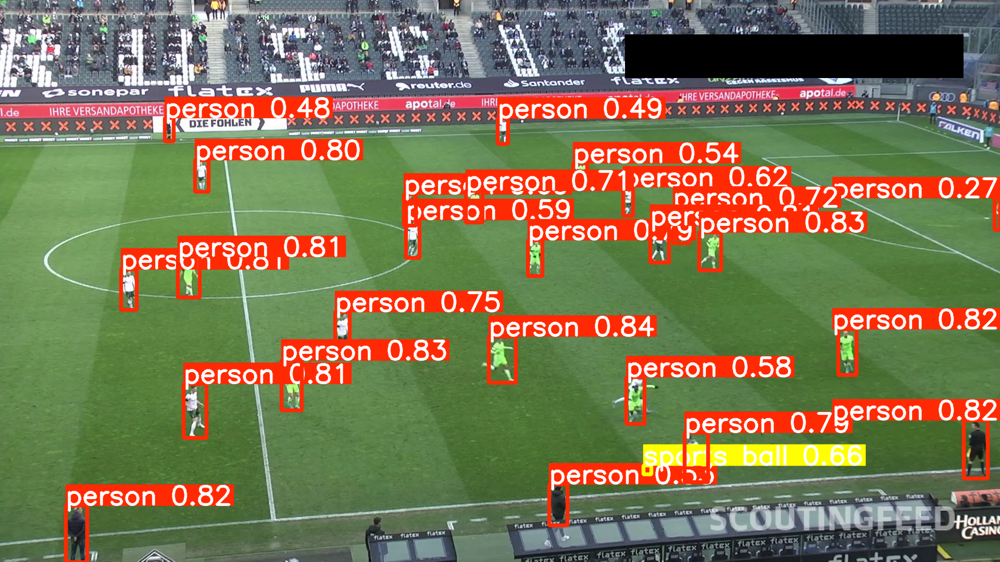

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


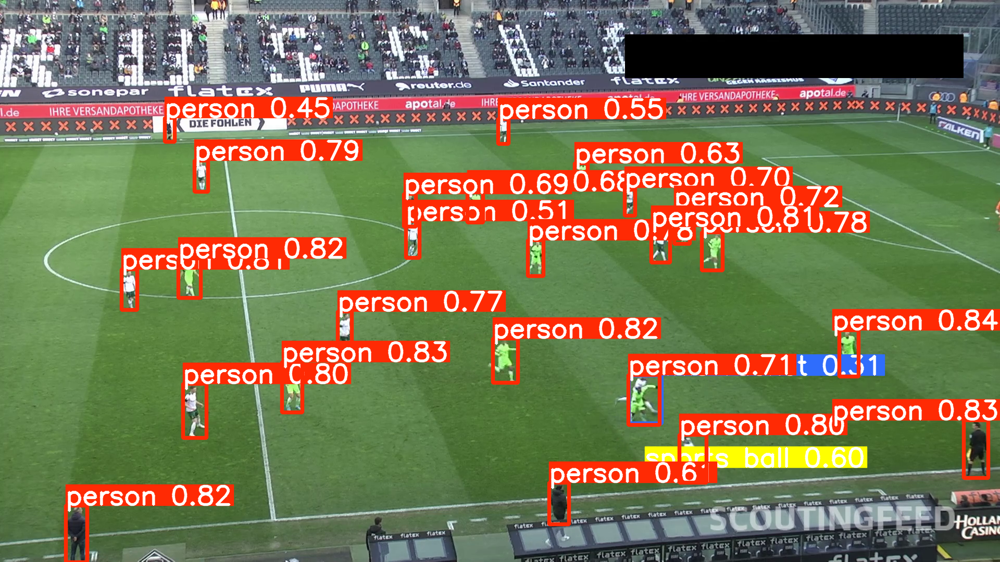

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


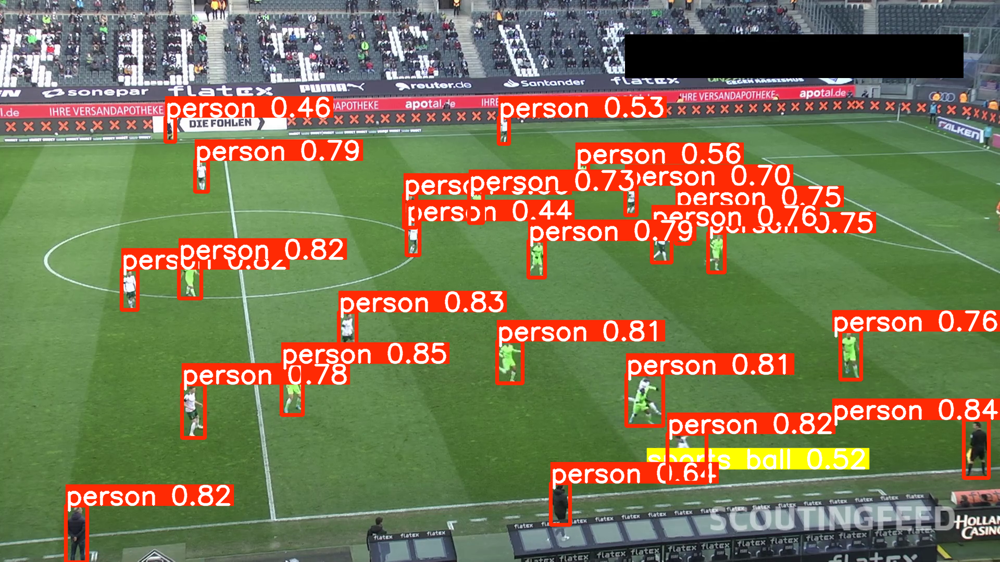

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []


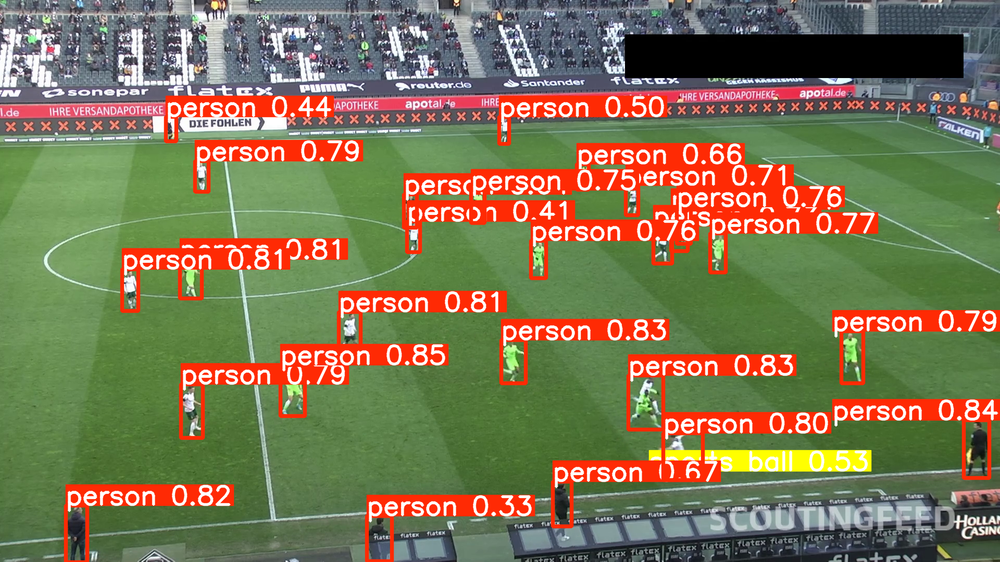

Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, name]
Index: []
Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import torch
from IPython.display import display
from PIL import Image as PILImage

# Load a larger YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5x')  # Use 'yolov5s', 'yolov5m', 'yolov5l', or 'yolov5x'

# Path to your video
video_path = '/content/drive/MyDrive/football_players_detection/match.mp4'

# Load the video
cap = cv2.VideoCapture(video_path)

# Confidence threshold for displaying detections
confidence_threshold = 0.9  # Adjust to see if it improves results

# Process the video frame by frame
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Perform object detection
    results = model(frame)

    # Filter detections based on confidence threshold
    detections = results.pandas().xyxy[0]
    filtered_detections = detections[detections['confidence'] >= confidence_threshold]

    # Print filtered detections with probabilities
    print(filtered_detections[['xmin', 'ymin', 'xmax', 'ymax', 'confidence', 'name']])

    # Render results on the frame
    frame_with_results = results.render()[0]

    # Convert frame with results to PIL Image format for displaying in Jupyter notebook
    frame_with_results = cv2.cvtColor(frame_with_results, cv2.COLOR_BGR2RGB)
    pil_image = PILImage.fromarray(frame_with_results)

    # Display the image
    display(pil_image)

# Release the video capture object
cap.release()


